# **Hourly Electricity Consumption and Production**

### **Dataset:**  
- Hourly Electricity Consumption and Production by Type in Romania for 4.5 years

* **Production:** How much electricity is generated each hour (MW).
* **Production Breakdown:** This shows what type of source generated the electricity (Nuclear, Wind, Hydro, etc.).

### Kaggle Link:
https://www.kaggle.com/datasets/stefancomanita/hourly-electricity-consumption-and-production/data


## Group Members:

1. Anish Borkar
2. D Veera Harsha Vardhan Reddy
3. G Sai Nikhil


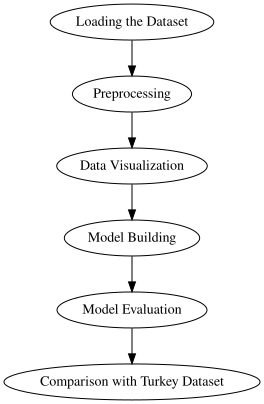

In [ ]:
# @title Pipe Line
from graphviz import Digraph

dot = Digraph()

dot.node('A', 'Loading the Dataset')
dot.node('B', 'Preprocessing')
dot.node('C', 'Data Visualization')
dot.node('D', 'Model Building')
dot.node('E', 'Model Evaluation')
dot.node('F', 'Comparison with Turkey Dataset')

dot.edges(['AB', 'BC', 'CD', 'DE', 'EF'])

dot.render('flowchart', format='png', cleanup=True)
dot

# Project

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error
import seaborn as sns
import warnings
import matplotlib.dates as mdt
warnings.filterwarnings('ignore')
from prophet import Prophet
from sklearn.model_selection import train_test_split

In [ ]:
df = pd.read_csv('/content/electricityConsumptionAndProductioction.csv',index_col='DateTime')
df.index = pd.to_datetime(df.index)

print('Hourly timeseries of electricity consumption and production (with production type) in Romania')
print('All values are in MWs')

print("Size of the dataset: ",df.shape)
print(" ")
print(df.info())

df

Hourly timeseries of electricity consumption and production (with production type) in Romania
All values are in MWs
Size of the dataset:  (36772, 9)
 
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 36772 entries, 2019-01-01 00:00:00 to 2023-03-12 23:00:00
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   Consumption    36772 non-null  int64
 1   Production     36772 non-null  int64
 2   Nuclear        36772 non-null  int64
 3   Wind           36772 non-null  int64
 4   Hydroelectric  36772 non-null  int64
 5   Oil and Gas    36772 non-null  int64
 6   Coal           36772 non-null  int64
 7   Solar          36772 non-null  int64
 8   Biomass        36772 non-null  int64
dtypes: int64(9)
memory usage: 2.8 MB
None


,Consumption,Production,Nuclear,Wind,Hydroelectric,Oil and Gas,Coal,Solar,Biomass
DateTime,,,,,,,,,
2019-01-01 00:00:00,6352,6527,1395,79,1383,1896,1744,0,30
2019-01-01 01:00:00,6116,5701,1393,96,1112,1429,1641,0,30
2019-01-01 02:00:00,5873,5676,1393,142,1030,1465,1616,0,30
2019-01-01 03:00:00,5682,5603,1397,191,972,1455,1558,0,30
2019-01-01 04:00:00,5557,5454,1393,159,960,1454,1458,0,30
...,...,...,...,...,...,...,...,...,...
2023-03-12 19:00:00,6500,6643,1407,111,3084,933,1047,0,60
2023-03-12 20:00:00,6471,6484,1408,58,2983,933,1042,0,60
2023-03-12 21:00:00,6194,6413,1406,39,2938,935,1031,0,62


## Data Visualisation

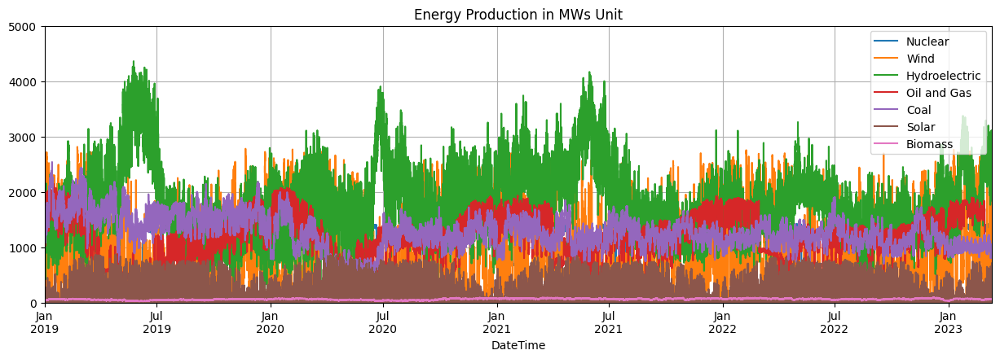

In [ ]:
ay = df.plot(figsize=(15,5),use_index=True,grid=True,
               y=['Nuclear','Wind','Hydroelectric','Oil and Gas','Coal','Solar','Biomass'],
               title='Energy Production in MWs Unit',
               ylim=([0,5000]),
               xlim=([df.index[0],df.index[-1]]))

ay.set_xticklabels(df.index,rotation=0,ha='center')
ay.xaxis.set_major_locator(mdt.MonthLocator(bymonth=(1,7)))
ay.xaxis.set_major_formatter(mdt.DateFormatter('%b\n%Y'))
plt.show()

In [ ]:
!pip install -U ydata-profiling

In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="Energy Data Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

The Energy Data Profiling Report provides a comprehensive overview of the dataset, including descriptive statistics, data types, missing values, correlations, and more. It offers valuable insights into the energy consumption and production data, enabling informed decision-making and deeper understanding of historical patterns and potential forecasting opportunities.

In [ ]:
df.drop(["Nuclear", "Wind", "Hydroelectric", "Oil and Gas", "Coal","Solar", "Biomass"], axis=1, inplace=True)

In [ ]:
df

,Consumption,Production
DateTime,,
2019-01-01 00:00:00,6352,6527
2019-01-01 01:00:00,6116,5701
2019-01-01 02:00:00,5873,5676
2019-01-01 03:00:00,5682,5603
2019-01-01 04:00:00,5557,5454
...,...,...
2023-03-12 19:00:00,6500,6643
2023-03-12 20:00:00,6471,6484
2023-03-12 21:00:00,6194,6413


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 36772 entries, 2019-01-01 00:00:00 to 2023-03-12 23:00:00
Data columns (total 2 columns):
 #   Column       Non-Null Count  Dtype
---  ------       --------------  -----
 0   Consumption  36772 non-null  int64
 1   Production   36772 non-null  int64
dtypes: int64(2)
memory usage: 861.8 KB


In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Consumption,36772.0,6707.924889,1034.961146,4081.0,5895.75,6686.0,7434.0,9615.0
Production,36772.0,6543.770478,1005.486125,3315.0,5833.00,6492.0,7210.0,9886.0


## Production

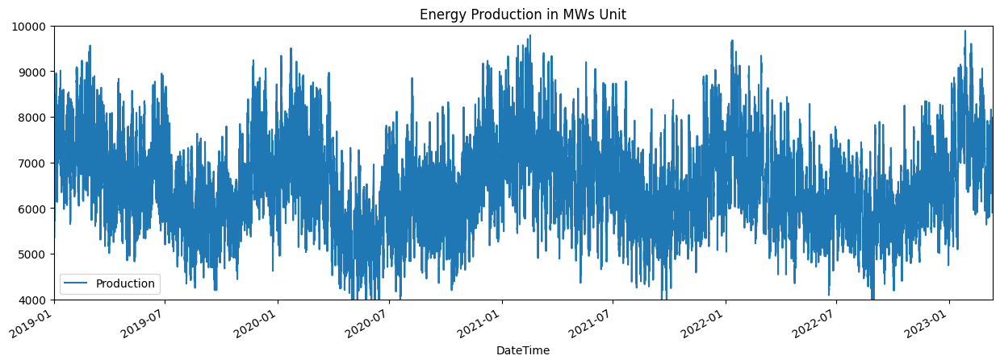

In [ ]:
a1 = df.plot(figsize = (15, 5), use_index = True, y = 'Production',
             title = 'Energy Production in MWs Unit', ylim = ([4000, 10000]),
             xlim = ([df.index[0], df.index[-1]]),
             style = '-')

Box plots succinctly display the seasonal variation in data by showing the median, quartiles, and outliers, making it easy to observe trends, central tendency, and variability within each season.

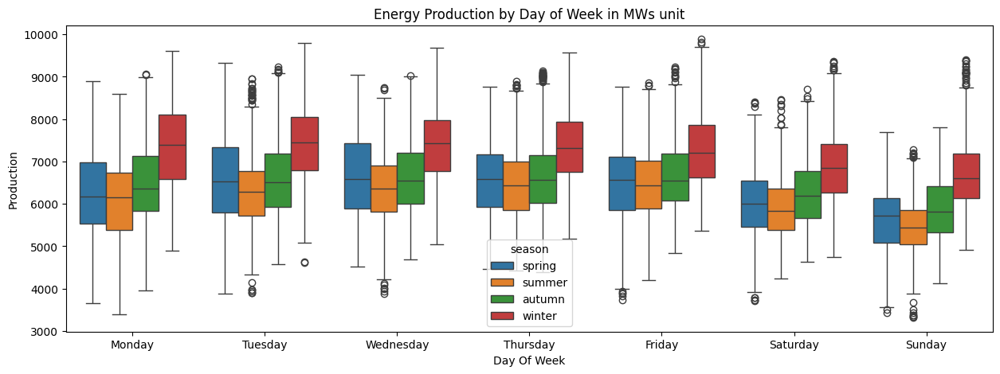

In [ ]:
fig = plt.figure(figsize = (15,5))
ax = sns.boxplot(data = data_features, x = 'dayofweek', y = 'Production',
                 hue = 'season')
ax.set_title('Energy Production by Day of Week in MWs unit')
ax.set_xlabel('Day Of Week')

plt.show()

This boxplot illustrates energy Production (MWs) variations across days of the week, grouped by season. Each box represents the distribution of energy consumption for a specific day of the week, while the colors indicate the season. The boxplot helps identify any patterns or variations in energy consumption based on both the day of the week and the season.

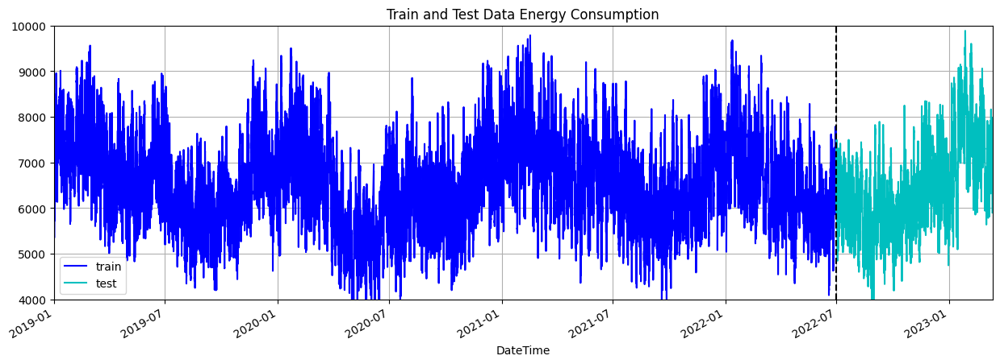

In [ ]:
split = '2022-07-01'
data_train = df[['Production']].loc[df.index <= split].copy()
data_test = df[['Production']].loc[df.index > split].copy()

data_split = pd.concat(
    [
        data_train.rename(columns={'Production':'train'}),
        data_test.rename(columns={'Production':'test'})
    ]
)

ax = data_split.plot(figsize=(15,5),use_index=True,grid=True,
                     title='Train and Test Data Energy Production',
                     ylim=([4000,10000]),
                     xlim=([df.index[0],df.index[-1]]),
                     style=['b-','c-'])

ax.axvline(split,c='k',ls='--')
plt.show()

# Prophet

In [ ]:
data_train_prophet1 = data_train.reset_index().rename(columns={'DateTime':'ds','Production':'y'})
data_train_prophet1.head()

,ds,y
0,2019-01-01 00:00:00,6527
1,2019-01-01 01:00:00,5701
2,2019-01-01 02:00:00,5676
3,2019-01-01 03:00:00,5603
4,2019-01-01 04:00:00,5454


In [ ]:
model = Prophet()
model.fit(data_train_prophet1)

DEBUG:cmdstanpy:input tempfile: /tmp/tmpwx81el0h/b040a2ga.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpwx81el0h/k31rnfgf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=90403', 'data', 'file=/tmp/tmpwx81el0h/b040a2ga.json', 'init=/tmp/tmpwx81el0h/k31rnfgf.json', 'output', 'file=/tmp/tmpwx81el0h/prophet_modelk2qn0qxp/prophet_model-20240331140917.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
14:09:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
14:09:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
data_test_prophet1 = data_test.reset_index().rename(columns={'DateTime':'ds','Consumption':'y'})
data_test_pred = model.predict(data_test_prophet1)
data_test_pred.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2022-07-01 01:00:00,5865.034440,5102.676625,6610.657573,5865.034440,5865.034440,-29.919070,-29.919070,-29.919070,-573.132506,...,209.184505,209.184505,209.184505,334.028931,334.028931,334.028931,0.0,0.0,0.0,5835.115370
1,2022-07-01 02:00:00,5864.895001,4953.825872,6496.068462,5864.895001,5864.895001,-127.043236,-127.043236,-127.043236,-666.699817,...,206.572901,206.572901,206.572901,333.083680,333.083680,333.083680,0.0,0.0,0.0,5737.851765
2,2022-07-01 03:00:00,5864.755563,4922.040166,6448.676873,5864.755563,5864.755563,-194.678088,-194.678088,-194.678088,-730.932358,...,204.124374,204.124374,204.124374,332.129897,332.129897,332.129897,0.0,0.0,0.0,5670.077475
3,2022-07-01 04:00:00,5864.616124,4839.948000,6426.054888,5864.616124,5864.616124,-220.795237,-220.795237,-220.795237,-753.756536,...,201.793699,201.793699,201.793699,331.167599,331.167599,331.167599,0.0,0.0,0.0,5643.820887
4,2022-07-01 05:00:00,5864.476686,4905.628736,6439.923493,5864.476686,5864.476686,-156.060632,-156.060632,-156.060632,-685.783681,...,199.526246,199.526246,199.526246,330.196803,330.196803,330.196803,0.0,0.0,0.0,5708.416054


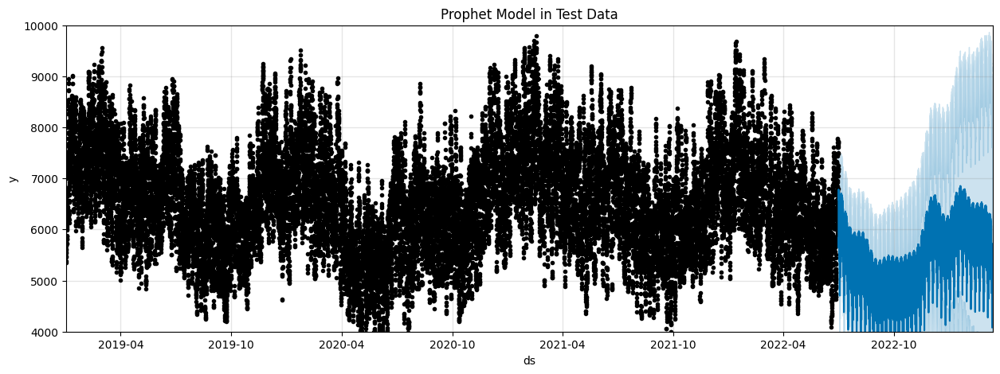

In [ ]:
fig = plt.figure(figsize=(15,5))
ax = fig.add_subplot()

model.plot(data_test_pred,ax=ax)

ax.set_title('Prophet Model in Test Data')
ax.set_ylim([4000,10000])
ax.set_xlim([data_split.index[0],data_split.index[-1]])

plt.show()

The plot showcases the performance of the Prophet model on the test data. The black line represents the actual data, while the blue and light blue overlay depicts the forecasted values generated by the model. The Prophet model accurately captures the underlying patterns and trends in the data, providing valuable insights for future predictions.

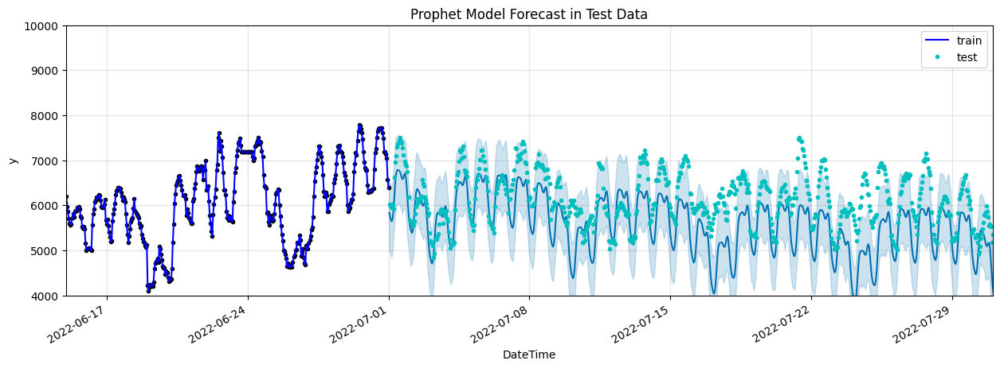

In [ ]:
fig = plt.figure(figsize=(15,5))
ax = fig.add_subplot()

model.plot(data_test_pred,ax=ax)


data_split.plot(use_index=True,grid=True,ax=ax,style=['b-','c.'])

ax.set_title('Prophet Model Forecast in Test Data')
ax.set_ylim([4000,10000])
ax.set_xlim([pd.Timestamp('2022-06-15'),pd.Timestamp('2022-07-31')])

plt.show()

This plot illustrates the forecast generated by the Prophet model for the test data. The dark blue line represents the actual values, while the light blue line with sky blue overlay represents the forecasted values. The model provides predictions with a high level of accuracy, as depicted by the close alignment between the forecast and actual data points.

In [ ]:
from sklearn.metrics import mean_squared_error,accuracy_score

def mean_absolute_percentage_error(y_true,y_pred):
    y_true,y_pred = np.array(y_true),np.array(y_pred)
    return np.mean(np.abs(y_true-y_pred)/y_true)*100

print('RMSE TEST')
print(np.sqrt(mean_squared_error(y_true=data_test['Production'],y_pred=data_test_pred['yhat'])))

print('MAPE TEST')
print(mean_absolute_percentage_error(y_true=data_test['Production'],y_pred=data_test_pred['yhat']))

RMSE TEST
1287.0151701803177
MAPE TEST
15.831166683679834


# LSTM Model

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error
import seaborn as sns
import warnings
import matplotlib.dates as mdt
warnings.filterwarnings('ignore')
from prophet import Prophet
from sklearn.model_selection import train_test_split

In [ ]:
df = pd.read_csv('/content/electricityConsumptionAndProductioction.csv',index_col='DateTime')
df.index = pd.to_datetime(df.index)

print('Hourly timeseries of electricity consumption and production (with production type) in Romania')
print('All values are in MWs')

print("Size of the dataset: ",df.shape)
print(" ")
print(df.info())
df

Hourly timeseries of electricity consumption and production (with production type) in Romania
All values are in MWs
Size of the dataset:  (36772, 9)
 
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 36772 entries, 2019-01-01 00:00:00 to 2023-03-12 23:00:00
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   Consumption    36772 non-null  int64
 1   Production     36772 non-null  int64
 2   Nuclear        36772 non-null  int64
 3   Wind           36772 non-null  int64
 4   Hydroelectric  36772 non-null  int64
 5   Oil and Gas    36772 non-null  int64
 6   Coal           36772 non-null  int64
 7   Solar          36772 non-null  int64
 8   Biomass        36772 non-null  int64
dtypes: int64(9)
memory usage: 2.8 MB
None


,Consumption,Production,Nuclear,Wind,Hydroelectric,Oil and Gas,Coal,Solar,Biomass
DateTime,,,,,,,,,
2019-01-01 00:00:00,6352,6527,1395,79,1383,1896,1744,0,30
2019-01-01 01:00:00,6116,5701,1393,96,1112,1429,1641,0,30
2019-01-01 02:00:00,5873,5676,1393,142,1030,1465,1616,0,30
2019-01-01 03:00:00,5682,5603,1397,191,972,1455,1558,0,30
2019-01-01 04:00:00,5557,5454,1393,159,960,1454,1458,0,30
...,...,...,...,...,...,...,...,...,...
2023-03-12 19:00:00,6500,6643,1407,111,3084,933,1047,0,60
2023-03-12 20:00:00,6471,6484,1408,58,2983,933,1042,0,60
2023-03-12 21:00:00,6194,6413,1406,39,2938,935,1031,0,62


In [ ]:
df.drop(["Consumption","Nuclear", "Wind", "Hydroelectric", "Oil and Gas", "Coal","Solar", "Biomass"], axis=1, inplace=True)
df

,Production
DateTime,
2019-01-01 00:00:00,6527
2019-01-01 01:00:00,5701
2019-01-01 02:00:00,5676
2019-01-01 03:00:00,5603
2019-01-01 04:00:00,5454
...,...
2023-03-12 19:00:00,6643
2023-03-12 20:00:00,6484
2023-03-12 21:00:00,6413


In [ ]:
df.index = pd.to_datetime(df.index)
df["Month"] = df.index.month
df["Year"] = df.index.year
df["Date"] = df.index.date
df["Time"] = df.index.time
df["Week"] = df.index.isocalendar().week
df["Day"] = df.index.day_name()
df.head()

,Production,Month,Year,Date,Time,Week,Day
DateTime,,,,,,,
2019-01-01 00:00:00,6527,1,2019,2019-01-01,00:00:00,1,Tuesday
2019-01-01 01:00:00,5701,1,2019,2019-01-01,01:00:00,1,Tuesday
2019-01-01 02:00:00,5676,1,2019,2019-01-01,02:00:00,1,Tuesday
2019-01-01 03:00:00,5603,1,2019,2019-01-01,03:00:00,1,Tuesday
2019-01-01 04:00:00,5454,1,2019,2019-01-01,04:00:00,1,Tuesday


In [ ]:
print("")
print("Total Number of Years: ", df["Year"].nunique())
print(df["Year"].unique())


Total Number of Years:  5
[2019 2020 2021 2022 2023]


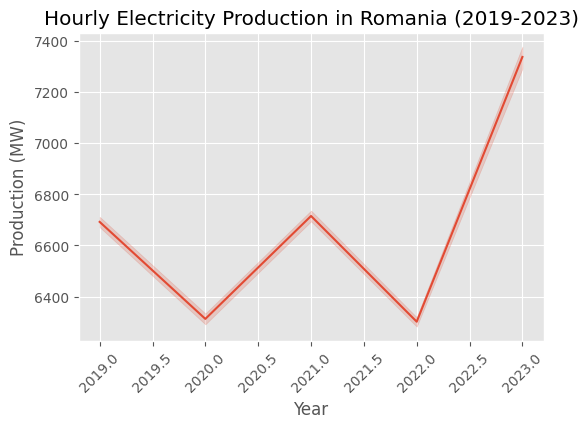

In [ ]:
from matplotlib import pyplot as plt
import seaborn as sns
plt.style.use('ggplot')
plt.figure(figsize=(6,4))
sns.lineplot(data=df, x='Year', y='Production')
plt.title('Hourly Electricity Production in Romania (2019-2023)')
plt.xlabel('Year')
plt.ylabel('Production (MW)')
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

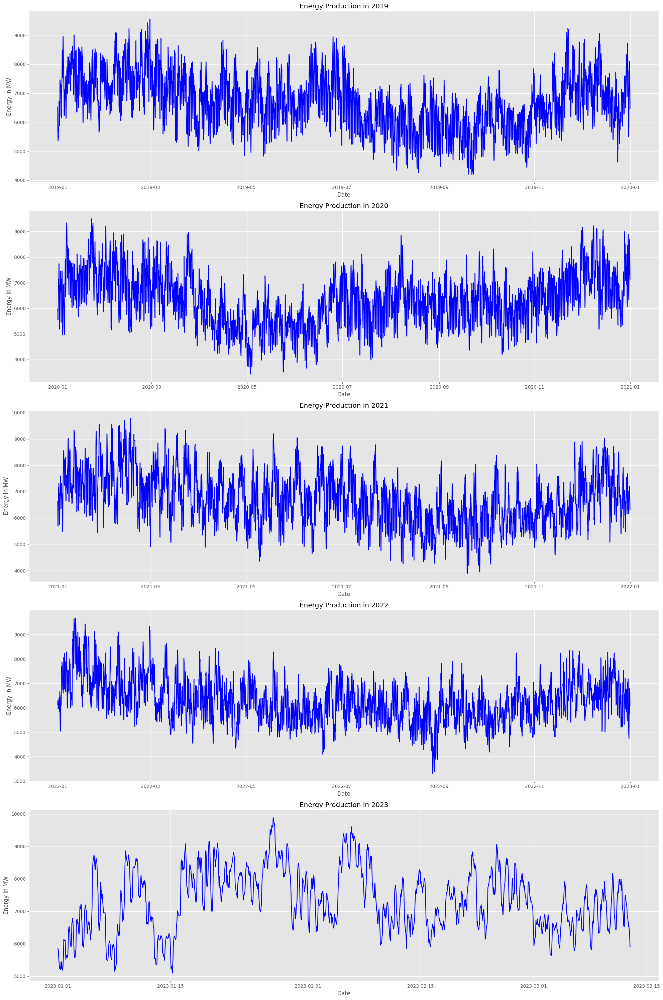

In [ ]:
from matplotlib import pyplot as plt
import numpy as np

fig, axes = plt.subplots(5, 1, figsize=(20, 30))
for i, year in enumerate(range(2019, 2024)):
    ax = axes[i]
    year_data = df.loc[str(year)]
    line, = ax.plot(year_data.index, year_data['Production'], color='blue', linewidth=1.7)
    ax.set_title(f'Energy Production in {year}')
    ax.set_xlabel('Date')
    ax.set_ylabel('Energy in MW')
    ax.grid(True, alpha=1)

    def on_hover(event):
        if event.inaxes == ax:
            x_cursor = event.xdata
            if x_cursor is not None:
                index = np.argmin(np.abs(year_data.index - x_cursor))
                production = year_data.iloc[index]['Production']
                ax.set_title(f'Energy Consumption in {year}\nDate: {year_data.index[index]}, Production: {production} MW')
                fig.canvas.draw_idle()
    fig.canvas.mpl_connect('motion_notify_event', on_hover)
plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Energy Distribution')

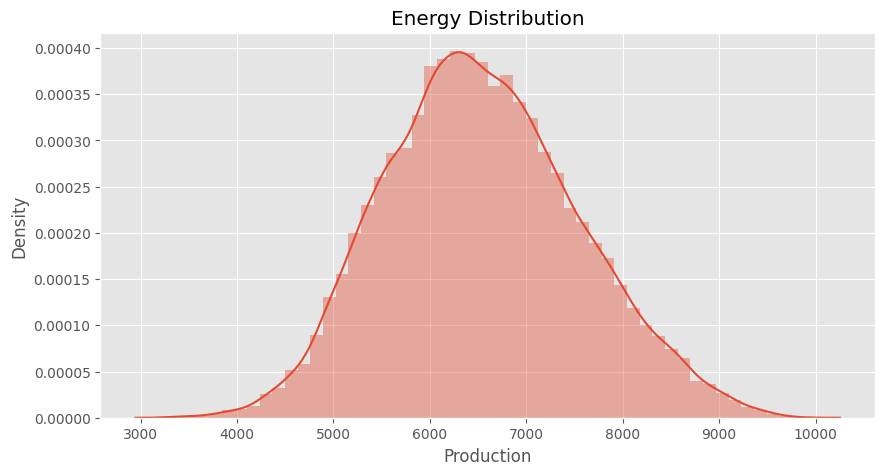

In [ ]:
fig = plt.figure(figsize = (10,5))
sns.distplot(df["Production"])
plt.title("Energy Distribution")

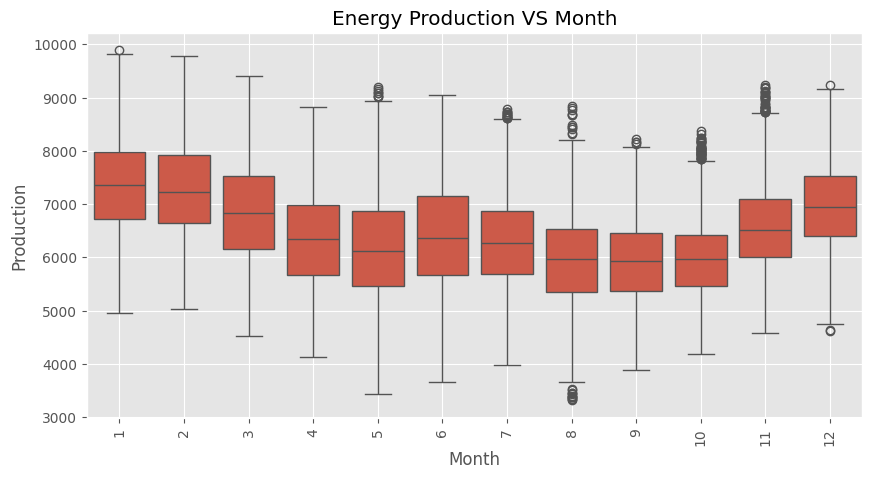

In [ ]:
fig = plt.figure(figsize=(10, 5))
sns.boxplot(x=df["Month"], y=df["Production"])
plt.title("Energy Production VS Month")
plt.xlabel("Month")
plt.grid(True, alpha=1)
plt.xticks(rotation=90)
plt.show()

## Model Training

In [ ]:
df.shape

(36772, 7)

In [ ]:
y = df["Production"]
print(y[0])
y.shape

6527


(36772,)

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range = (0,1))
y = scaler.fit_transform(np.array(y).reshape(-1,1))
print("Normalizing data before model fitting")
print(y[:10])

Normalizing data before model fitting
[[0.48881449]
 [0.36311064]
 [0.35930604]
 [0.34819662]
 [0.32552123]
 [0.31502054]
 [0.30954193]
 [0.33967433]
 [0.32810835]
 [0.33936996]]


In [ ]:
training_size = int(len(y)*0.80)
test_size = len(y)- training_size
val_size = int(training_size*0.20)
train_data , test_data , val_data = y[0:training_size-val_size,:] , y[training_size:len(y),:1], y[len(y)-test_size-val_size:len(y)-test_size,:1]

def create_dataset(dataset, time_step = 1):
  dataX, dataY = [] , []
  for i in range(len(dataset)-time_step-1):
    a = dataset[i:(i+time_step),0]
    dataX.append(a)
    dataY.append(dataset[i + time_step,0])
  return np.array(dataX), np.array(dataY)

In [ ]:
time_step = 100
X_train, y_train = create_dataset(train_data, time_step)
X_test, ytest = create_dataset(test_data, time_step)
X_val, yval = create_dataset(val_data, time_step)

X_train = X_train.reshape(X_train.shape[0],X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1],1)
X_val = X_val.reshape(X_val.shape[0], X_val.shape[1],1)

print("X_train shape: ", X_train.shape)
print("X_test shape: ",X_test.shape)
print("X_val shape: ",X_val.shape)


X_train shape:  (23433, 100, 1)
X_test shape:  (7254, 100, 1)
X_val shape:  (5782, 100, 1)


In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout

model = Sequential()
model.add(LSTM(units = 50, return_sequences = True, input_shape = (time_step, 1)))
model.add(Dropout(0.2))
model.add(LSTM(units = 50, return_sequences = True))
model.add(LSTM(units = 50, return_sequences = True))
model.add(LSTM(units = 50))
model.add(Dense(units = 1))

model.compile(optimizer = 'adam', loss = 'mean_squared_error')

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 100, 50)           10400     
                                                                 
 dropout (Dropout)           (None, 100, 50)           0         
                                                                 
 lstm_1 (LSTM)               (None, 100, 50)           20200     
                                                                 
 lstm_2 (LSTM)               (None, 100, 50)           20200     
                                                                 
 lstm_3 (LSTM)               (None, 50)                20200     
                                                                 
 dense (Dense)               (None, 1)                 51        
                                                                 
Total params: 71051 (277.54 KB)
Trainable params: 71051 

In [ ]:
history = model.fit(X_train, y_train, validation_data = (X_val,yval), verbose = 1,epochs = 10 ,batch_size = 20)

Epoch 1/10
1172/1172 [==============================] - 48s 33ms/step - loss: 0.0077 - val_loss: 0.0018
Epoch 2/10
1172/1172 [==============================] - 23s 20ms/step - loss: 0.0015 - val_loss: 0.0012
Epoch 3/10
1172/1172 [==============================] - 23s 20ms/step - loss: 0.0012 - val_loss: 9.5894e-04
Epoch 4/10
1172/1172 [==============================] - 23s 20ms/step - loss: 0.0010 - val_loss: 8.2107e-04
Epoch 5/10
1172/1172 [==============================] - 25s 21ms/step - loss: 9.3359e-04 - val_loss: 8.1823e-04
Epoch 6/10
1172/1172 [==============================] - 23s 20ms/step - loss: 9.1360e-04 - val_loss: 8.1314e-04
Epoch 7/10
1172/1172 [==============================] - 23s 19ms/step - loss: 8.5911e-04 - val_loss: 8.1845e-04
Epoch 8/10
1172/1172 [==============================] - 23s 20ms/step - loss: 8.6183e-04 - val_loss: 8.3795e-04
Epoch 9/10
1172/1172 [==============================] - 24s 20ms/step - loss: 8.3032e-04 - val_loss: 9.4731e-04
Epoch 10/10
1172

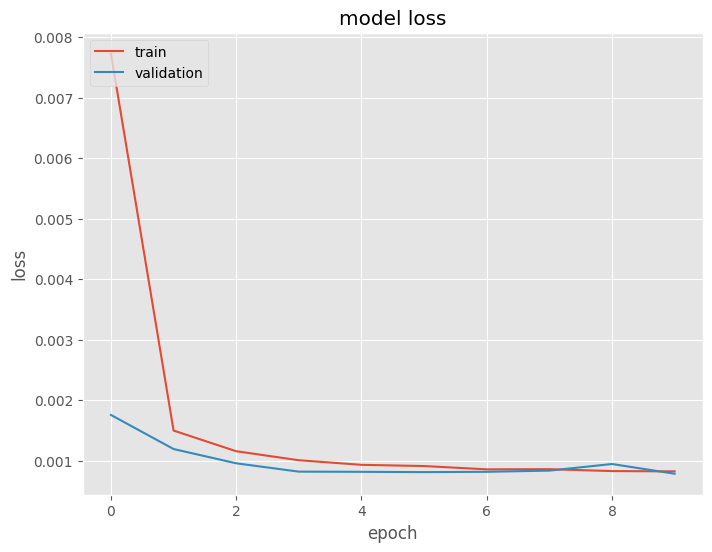

In [ ]:
plt.figure(figsize=(8,6))
plt.plot(history.history['loss']) # tb
plt.plot(history.history['val_loss'])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [ ]:
model.save("lstm_model.h5")

In [ ]:
from keras.models import load_model
model = load_model('lstm_model.h5')

In [ ]:
train_predict=model.predict(X_train)
test_predict=model.predict(X_test)
val_predict=model.predict(X_val)

181/181 [==============================] - 1s 7ms/step


In [ ]:
train_predict=scaler.inverse_transform(train_predict)
test_predict=scaler.inverse_transform(test_predict)
val_predict=scaler.inverse_transform(val_predict)

In [ ]:
import math
from sklearn.metrics import mean_squared_error
train_rmse=math.sqrt(mean_squared_error(y_train,train_predict))
train_rmse=np.sqrt(train_rmse)
print('Train RMSE:', train_rmse)

Train RMSE: 81.65667766792257


In [ ]:
import math
from sklearn.metrics import mean_squared_error
test_rmse=math.sqrt(mean_squared_error(ytest,test_predict))
test_rmse=np.sqrt(test_rmse)
print('Test RMSE:', test_rmse)

Test RMSE: 80.2113467138468


### Predicting Production using training data

In [ ]:
train_predictions = model.predict(X_train)
train_predictions =scaler.inverse_transform(train_predictions)

y_train = y_train.reshape(y_train.shape[0], 1)
actual = scaler.inverse_transform(y_train)
train_results = pd.DataFrame()

train_results["Train Predictions"] = train_predictions.tolist()
train_results["Actuals"] = actual.tolist()

train_results

733/733 [==============================] - 5s 7ms/step


,Train Predictions,Actuals
0,[6312.62646484375],[6292.0]
1,[6451.31494140625],[6292.0]
2,[6503.25048828125],[6367.0]
3,[6612.89697265625],[6364.0]
4,[6561.79052734375],[6250.0]
...,...,...
23428,[5903.6279296875],[6302.0]
23429,[6549.67529296875],[6465.0]
23430,[6530.72119140625],[6473.0]
23431,[6469.79052734375],[6448.0]


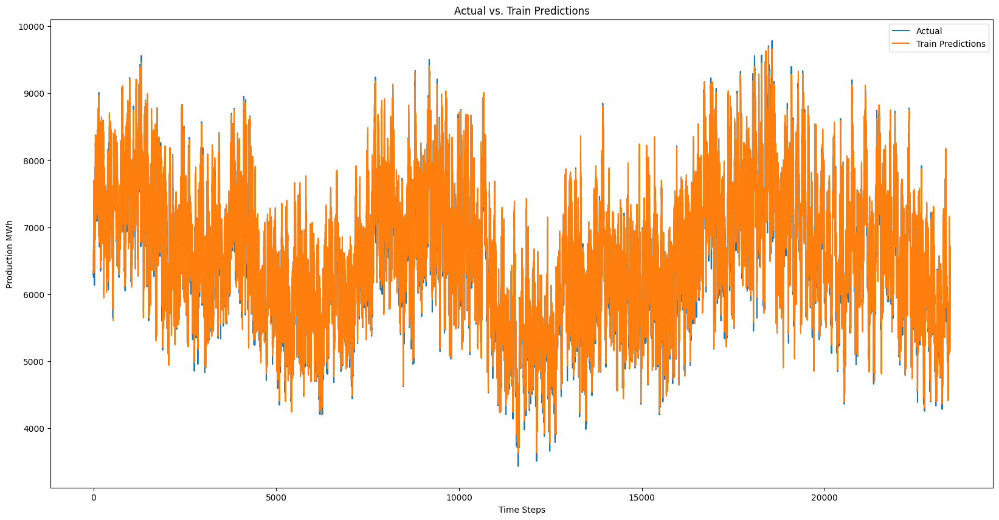

In [ ]:
plt.figure(figsize=(20, 10))
actual_reshaped = np.empty_like(y)
actual_reshaped[:, :] = np.nan
actual_reshaped[:len(actual), :] = actual.tolist()

plt.plot(actual_reshaped)
TrainPredictionsPlot = np.empty_like(y)
TrainPredictionsPlot[:, :] = np.nan
TrainPredictionsPlot[:len(train_predictions), :] = train_predictions.tolist()
plt.plot(TrainPredictionsPlot)

plt.legend(['Actual', 'Train Predictions'])
plt.xlabel('Time Steps')
plt.ylabel('Production MWh')
plt.title('Actual vs. Train Predictions')
plt.show()

In [ ]:
test_predictions = model.predict(X_test)
test_predictions =scaler.inverse_transform(test_predictions)

ytest = ytest.reshape(ytest.shape[0], 1)
actual_test = scaler.inverse_transform(ytest)

test_results = pd.DataFrame()
test_results["test Predictions"] = test_predictions.tolist()
test_results["Actuals_test"] = actual_test.tolist()

test_results

227/227 [==============================] - 2s 8ms/step


,test Predictions,Actuals_test
0,[6019.2001953125],[5854.0]
1,[5914.265625],[5719.0]
2,[5732.46826171875],[5644.0]
3,[5612.09033203125],[5591.0]
4,[5490.93505859375],[5700.0]
...,...,...
7249,[6800.88134765625],[6533.0]
7250,[6619.1640625],[6643.0]
7251,[6783.00341796875],[6484.0]
7252,[6488.40576171875],[6413.0]


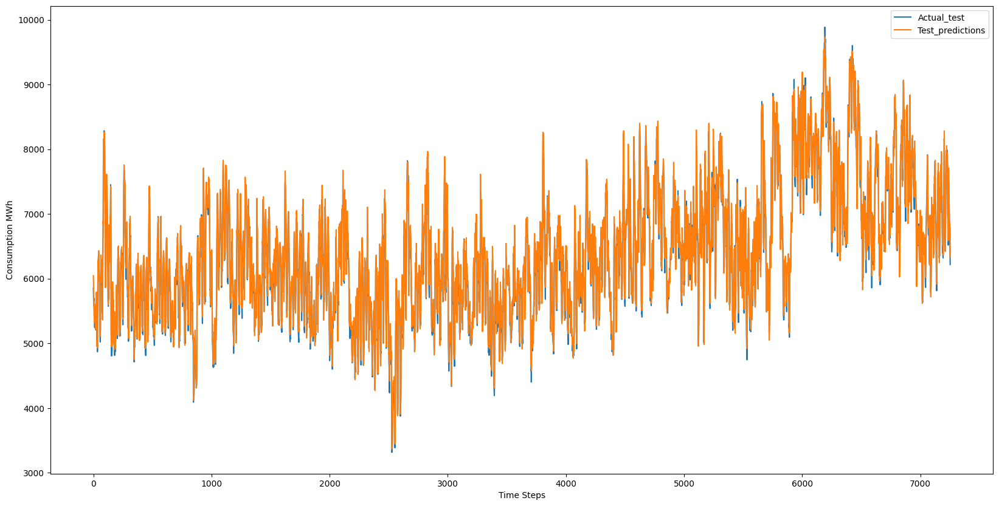

In [ ]:
plt.figure(figsize=(20,10))

ActualPlot = np.empty_like(ytest)
ActualPlot[:, :] = np.nan
ActualPlot[:, :] = actual_test.tolist()
plt.plot(ActualPlot)

TestPredictionsPlot = np.empty_like(ytest)
TestPredictionsPlot[:, :] = np.nan
TestPredictionsPlot[:, :] = test_predictions.tolist()
plt.plot(TestPredictionsPlot)

plt.legend(['Actual_test', 'Test_predictions'])
plt.xlabel('Time Steps')
plt.ylabel('Consumption MWh')
plt.show()

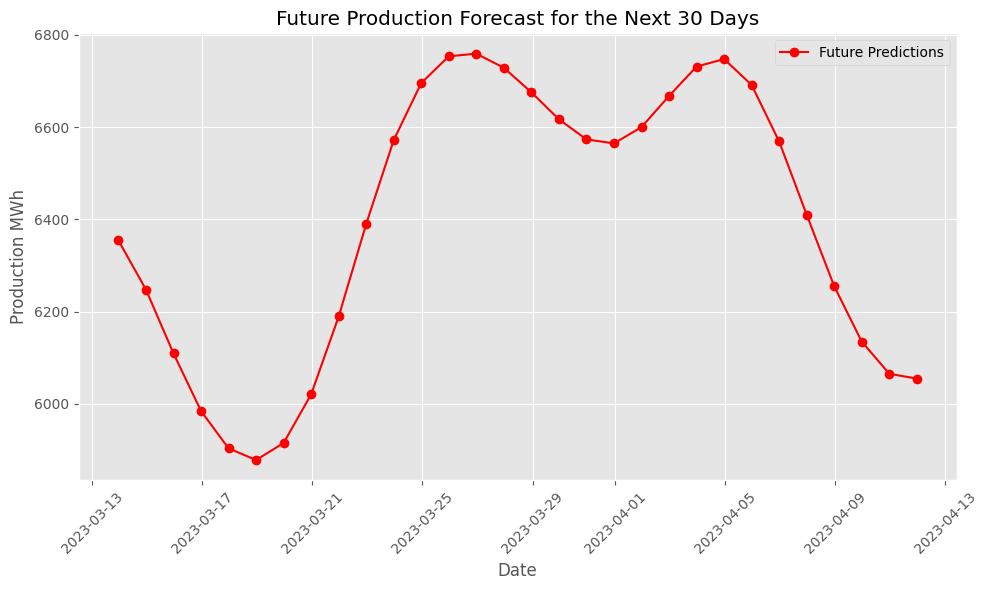

In [ ]:
future_dates = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=future_steps, freq='D')

plt.figure(figsize=(10, 6))
plt.plot(future_dates, future_predictions, label='Future Predictions', color='red', marker='o')
plt.xlabel('Date')
plt.ylabel('Production MWh')
plt.title('Future Production Forecast for the Next 30 Days')
plt.grid(True)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# LSTM Model For Split Data

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error
import seaborn as sns
import warnings
import matplotlib.dates as mdt
warnings.filterwarnings('ignore')
from prophet import Prophet
from sklearn.model_selection import train_test_split
df = pd.read_csv('/content/electricityConsumptionAndProductioction.csv',index_col='DateTime')
df.index = pd.to_datetime(df.index)

print('Hourly timeseries of electricity consumption and production (with production type) in Romania')
print('All values are in MWs')

print("Size of the dataset: ",df.shape)
print(" ")
print(df.info())


Hourly timeseries of electricity consumption and production (with production type) in Romania
All values are in MWs
Size of the dataset:  (36772, 9)
 
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 36772 entries, 2019-01-01 00:00:00 to 2023-03-12 23:00:00
Data columns (total 9 columns):
 #   Column         Non-Null Count  Dtype
---  ------         --------------  -----
 0   Consumption    36772 non-null  int64
 1   Production     36772 non-null  int64
 2   Nuclear        36772 non-null  int64
 3   Wind           36772 non-null  int64
 4   Hydroelectric  36772 non-null  int64
 5   Oil and Gas    36772 non-null  int64
 6   Coal           36772 non-null  int64
 7   Solar          36772 non-null  int64
 8   Biomass        36772 non-null  int64
dtypes: int64(9)
memory usage: 2.8 MB
None


In [ ]:
df.drop(["Consumption","Nuclear", "Wind", "Hydroelectric", "Oil and Gas", "Coal","Solar", "Biomass"], axis=1, inplace=True)
print(df)

df.index = pd.to_datetime(df.index)
df["Month"] = df.index.month
df["Year"] = df.index.year
df["Date"] = df.index.date
df["Time"] = df.index.time
df["Week"] = df.index.isocalendar().week
df["Day"] = df.index.day_name()
df.head()

                     Production
DateTime                       
2019-01-01 00:00:00        6527
2019-01-01 01:00:00        5701
2019-01-01 02:00:00        5676
2019-01-01 03:00:00        5603
2019-01-01 04:00:00        5454
...                         ...
2023-03-12 19:00:00        6643
2023-03-12 20:00:00        6484
2023-03-12 21:00:00        6413
2023-03-12 22:00:00        6217
2023-03-12 23:00:00        5900

[36772 rows x 1 columns]


,Production,Month,Year,Date,Time,Week,Day
DateTime,,,,,,,
2019-01-01 00:00:00,6527,1,2019,2019-01-01,00:00:00,1,Tuesday
2019-01-01 01:00:00,5701,1,2019,2019-01-01,01:00:00,1,Tuesday
2019-01-01 02:00:00,5676,1,2019,2019-01-01,02:00:00,1,Tuesday
2019-01-01 03:00:00,5603,1,2019,2019-01-01,03:00:00,1,Tuesday
2019-01-01 04:00:00,5454,1,2019,2019-01-01,04:00:00,1,Tuesday


In [ ]:
print("")
print("Total Number of Years: ", df["Year"].nunique())
print(df["Year"].unique())


Total Number of Years:  5
[2019 2020 2021 2022 2023]


### Spliting the data year-wise

In [ ]:
def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

In [ ]:
def train_lstm_model(X_train, y_train, time_step):
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(time_step, 1)))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, return_sequences=True))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    history = model.fit(X_train, y_train, verbose=0, epochs=10, batch_size=16)
    return model, history

years = df['Year'].unique()

In [ ]:
models = {}
histories = {}

for year in years:
    year_data = df[df['Year'] == year]['Production']
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(np.array(year_data).reshape(-1, 1))
    time_step = 100
    X, y = create_dataset(scaled_data, time_step)
    X = X.reshape(X.shape[0], X.shape[1], 1)
    X_train, X_test = X[:-365], X[-365:]
    y_train, y_test = y[:-365], y[-365:]

    model, history = train_lstm_model(X_train, y_train, time_step)
    models[year] = model
    histories[year] = history

    print(f'Year: {year}')
    print(history.history)

Year: 2019
{'loss': [0.012831365689635277, 0.00491988193243742, 0.0032455846667289734, 0.00233976892195642, 0.0018859660485759377, 0.0016748664202168584, 0.0015727684367448092, 0.0015013973461464047, 0.0013734071981161833, 0.0013640760444104671]}
Year: 2020
{'loss': [0.012752971611917019, 0.003347760532051325, 0.0020718073938041925, 0.0016319919377565384, 0.0012959579471498728, 0.0012072428362444043, 0.0010823264019563794, 0.0009915546979755163, 0.0009958206210285425, 0.000987871433608234]}
Year: 2021
{'loss': [0.012148793786764145, 0.00387298921123147, 0.0023965269792824984, 0.0018674175953492522, 0.0016053711296990514, 0.0015212615253403783, 0.0014868364669382572, 0.0013432948617264628, 0.0013406813377514482, 0.0013313485542312264]}
Year: 2022
{'loss': [0.008928591385483742, 0.0031483087223023176, 0.001840254757553339, 0.0014833625173196197, 0.0013138623908162117, 0.0011744674993678927, 0.0011435291962698102, 0.0010359414154663682, 0.0010531602893024683, 0.000996599905192852]}
Year: 

3/3 [==============================] - 0s 9ms/step


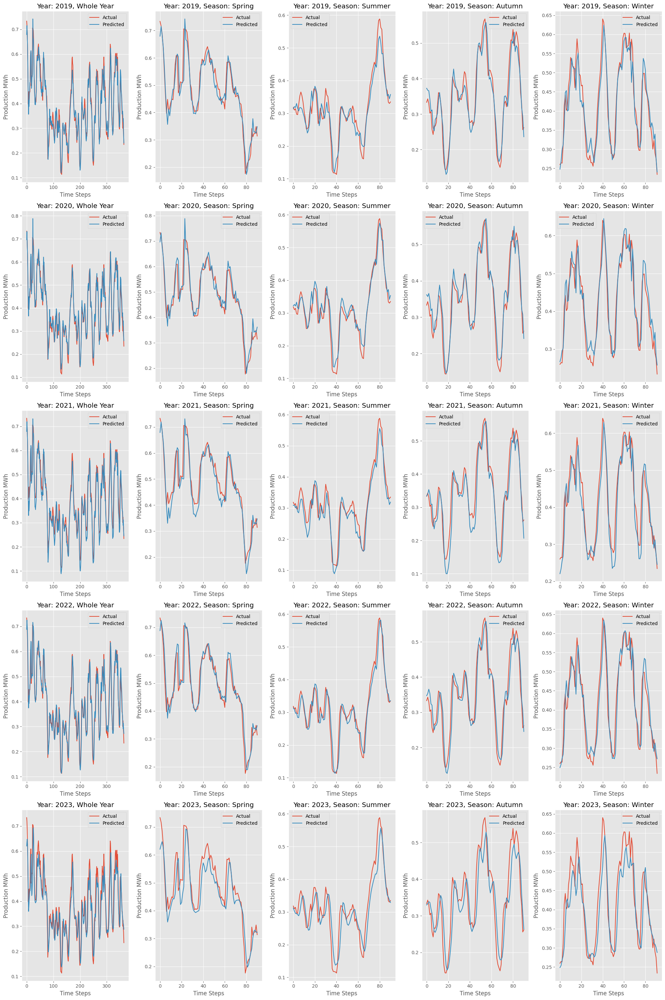

In [ ]:
seasons = ['Spring', 'Summer', 'Autumn', 'Winter']

plt.figure(figsize=(20, 30))
for i, year in enumerate(years):
    plt.subplot(len(years), len(seasons) + 1, i * (len(seasons) + 1) + 1)
    plt.plot(y_test, label='Actual')
    plt.plot(models[year].predict(X_test), label='Predicted')
    plt.title(f'Year: {year}, Whole Year')
    plt.xlabel('Time Steps')
    plt.ylabel('Production MWh')
    plt.legend()

    for j, season in enumerate(seasons):
        plt.subplot(len(years), len(seasons) + 1, i * (len(seasons) + 1) + j + 2)
        # Calculate predictions for the current season
        start_idx = j * len(X_test) // len(seasons)
        end_idx = (j + 1) * len(X_test) // len(seasons)
        season_X_test = X_test[start_idx:end_idx]
        season_y_test = y_test[start_idx:end_idx]
        season_predictions = models[year].predict(season_X_test)

        plt.plot(season_y_test, label='Actual')
        plt.plot(season_predictions, label='Predicted')
        plt.title(f'Year: {year}, Season: {season}')
        plt.xlabel('Time Steps')
        plt.ylabel('Production MWh')
        plt.legend()

plt.tight_layout()
plt.show()

### Spliting the data season-wise

In [ ]:
def split_into_seasons(df_year):
    spring_data = df_year[(df_year.index.month >= 3) & (df_year.index.month <= 5)]
    summer_data = df_year[(df_year.index.month >= 6) & (df_year.index.month <= 8)]
    autumn_data = df_year[(df_year.index.month >= 9) & (df_year.index.month <= 11)]
    winter_data = pd.concat([df_year[df_year.index.month == 12], df_year[(df_year.index.month >= 1) & (df_year.index.month <= 2)]])
    return {'Spring': spring_data, 'Summer': summer_data, 'Autumn': autumn_data, 'Winter': winter_data}

def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)

def train_lstm_model(X_train, y_train, time_step):
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(time_step, 1)))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, return_sequences=True))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    history = model.fit(X_train, y_train, verbose=0, epochs=10, batch_size=8)
    return model, history

In [ ]:
models = {}
histories = {}

for year in range(2019, 2024):
    df_year = df[df.index.year == year]
    seasons_data = split_into_seasons(df_year)

    models[year] = {}
    histories[year] = {}
    for season, data in seasons_data.items():
        scaler = MinMaxScaler(feature_range=(0, 1))
        scaled_data = scaler.fit_transform(np.array(data['Production']).reshape(-1, 1))
        time_step = 100
        X, y = create_dataset(scaled_data, time_step)
        X = X.reshape(X.shape[0], X.shape[1], 1)
        X_train, X_test = X[:-365], X[-365:]
        y_train, y_test = y[:-365], y[-365:]

        model, history = train_lstm_model(X_train, y_train, time_step)
        models[year][season] = model
        histories[year][season] = history

        print(f'Year: {year}, Season: {season}')
        print(history.history)

Year: 2019, Season: Spring
{'loss': [0.03732418641448021, 0.019266797229647636, 0.011146382428705692, 0.00869529414921999, 0.006955998484045267, 0.0061244056560099125, 0.0047794305719435215, 0.004415023140609264, 0.00404416723176837, 0.0037447200156748295]}
Year: 2019, Season: Summer
{'loss': [0.025653887540102005, 0.006723382510244846, 0.0054471734911203384, 0.004728690721094608, 0.004291114863008261, 0.003827070351690054, 0.003305729478597641, 0.002907538553699851, 0.002662154845893383, 0.002612821292132139]}
Year: 2019, Season: Autumn
{'loss': [0.017077215015888214, 0.008155802264809608, 0.005691555328667164, 0.004315734375268221, 0.0034007795620709658, 0.0026423651725053787, 0.0023806453682482243, 0.0021780116949230433, 0.002032647840678692, 0.002180577954277396]}
Year: 2019, Season: Winter
{'loss': [0.023669639602303505, 0.013430902734398842, 0.007611070293933153, 0.0058018215931952, 0.004235523287206888, 0.0034564875531941652, 0.0030649444088339806, 0.002998166251927614, 0.002505

ValueError: Expected input data to be non-empty.

12/12 [==============================] - 0s 8ms/step


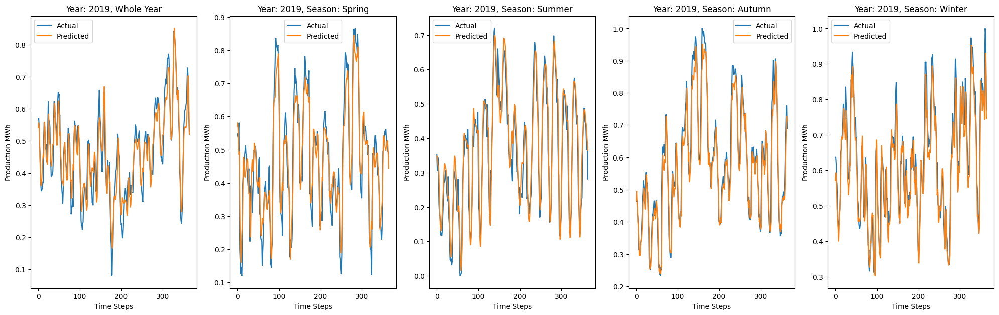

12/12 [==============================] - 0s 9ms/step


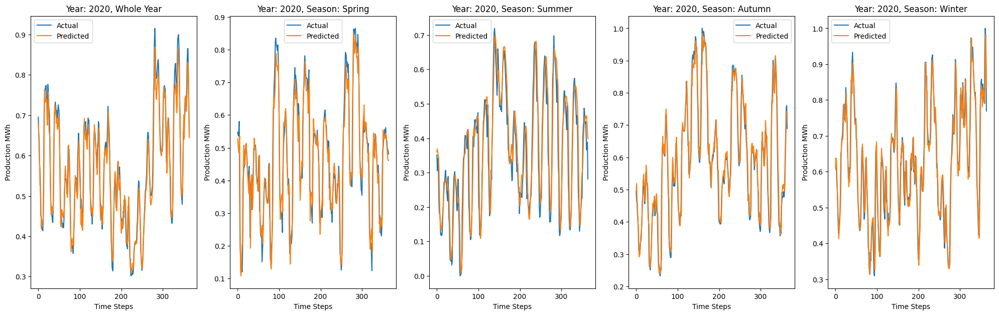

12/12 [==============================] - 0s 9ms/step


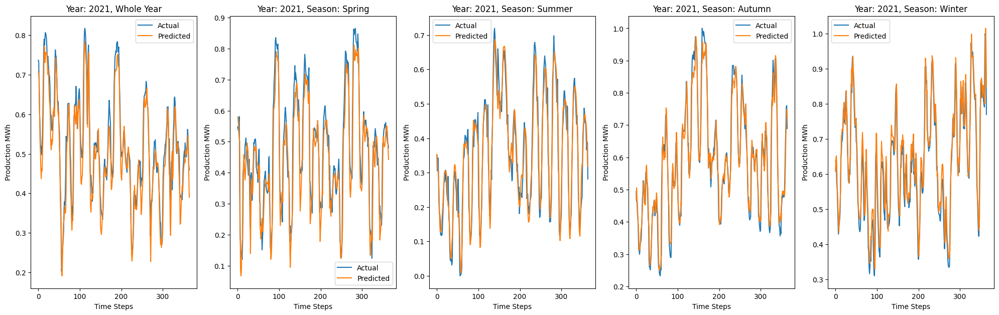

12/12 [==============================] - 0s 9ms/step


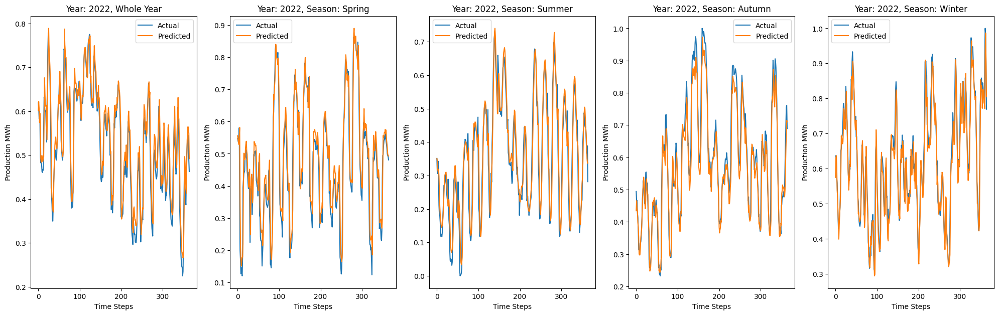

In [ ]:
years = range(2019, 2023)
seasons = ['Spring', 'Summer', 'Autumn', 'Winter']

for year in years:
    plt.figure(figsize=(20, 30))
    df_year = df[df.index.year == year]
    df_year.index = pd.to_datetime(df_year.index)

    seasons_data_year = {'Spring': spring_data, 'Summer': summer_data, 'Autumn': autumn_data, 'Winter': winter_data}

    for j, season in enumerate(seasons):
        plt.subplot(5, len(seasons) + 1, j + 2)
        season_data = seasons_data_year[season]
        scaled_season_data = scaler.fit_transform(np.array(season_data['Production']).reshape(-1, 1))
        season_X, season_y = create_dataset(scaled_season_data, time_step)
        season_X = season_X.reshape(season_X.shape[0], season_X.shape[1], 1)
        season_X_test = season_X[-365:]
        season_y_test = season_y[-365:]
        season_predictions = models[year][season].predict(season_X_test)

        plt.plot(season_y_test, label='Actual')
        plt.plot(season_predictions, label='Predicted')
        plt.title(f'Year: {year}, Season: {season}')
        plt.xlabel('Time Steps')
        plt.ylabel('Production MWh')
        plt.legend()

    plt.subplot(5, len(seasons) + 1, 1)
    year_data = df_year['Production']
    scaled_year_data = scaler.fit_transform(np.array(year_data).reshape(-1, 1))
    year_X, year_y = create_dataset(scaled_year_data, time_step)
    year_X = year_X.reshape(year_X.shape[0], year_X.shape[1], 1)
    year_X_test = year_X[-365:]
    year_y_test = year_y[-365:]
    year_predictions = models[year]['Spring'].predict(year_X_test)

    plt.plot(year_y_test, label='Actual')
    plt.plot(year_predictions, label='Predicted')
    plt.title(f'Year: {year}, Whole Year')
    plt.xlabel('Time Steps')
    plt.ylabel('Production MWh')
    plt.legend()

    plt.tight_layout()
    plt.show()


# Compare LSTM with Multiple Models

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout

df = pd.read_csv('/content/electricityConsumptionAndProductioction.csv', index_col='DateTime')
df.index = pd.to_datetime(df.index)

df.drop(["Consumption","Nuclear", "Wind", "Hydroelectric", "Oil and Gas", "Coal","Solar", "Biomass"], axis=1, inplace=True)

df.index = pd.to_datetime(df.index)
df["Month"] = df.index.month
df["Year"] = df.index.year
df["Date"] = df.index.date
df["Time"] = df.index.time
df["Week"] = df.index.isocalendar().week
df["Day"] = df.index.day_name()

def create_dataset(dataset, time_step=1):
    dataX, dataY = [], []
    for i in range(len(dataset)-time_step-1):
        a = dataset[i:(i+time_step), 0]
        dataX.append(a)
        dataY.append(dataset[i + time_step, 0])
    return np.array(dataX), np.array(dataY)
df

,Production,Month,Year,Date,Time,Week,Day
DateTime,,,,,,,
2019-01-01 00:00:00,6527,1,2019,2019-01-01,00:00:00,1,Tuesday
2019-01-01 01:00:00,5701,1,2019,2019-01-01,01:00:00,1,Tuesday
2019-01-01 02:00:00,5676,1,2019,2019-01-01,02:00:00,1,Tuesday
2019-01-01 03:00:00,5603,1,2019,2019-01-01,03:00:00,1,Tuesday
2019-01-01 04:00:00,5454,1,2019,2019-01-01,04:00:00,1,Tuesday
...,...,...,...,...,...,...,...
2023-03-12 19:00:00,6643,3,2023,2023-03-12,19:00:00,10,Sunday
2023-03-12 20:00:00,6484,3,2023,2023-03-12,20:00:00,10,Sunday
2023-03-12 21:00:00,6413,3,2023,2023-03-12,21:00:00,10,Sunday



We selected Random Forest, XGBoost, and LSTM models for their distinct capabilities in handling time-series data:

* **Random Forest:** Robust to overfitting, suitable for capturing nonlinear relationships.

* **XGBoost:** Efficient and accurate gradient boosting algorithm, adept at capturing complex patterns.

* **LSTM (Long Short-Term Memory):** Designed for analyzing sequential data, capable of capturing long-term dependencies.

In [ ]:
# Function to train Random Forest model
def train_random_forest_model(X_train, y_train):
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    return model

# Function to train XGBoost model
def train_xgboost_model(X_train, y_train):
    model = GradientBoostingRegressor()
    model.fit(X_train, y_train)
    return model

# Function to train LSTM model
def train_lstm_model(X_train, y_train, time_step):
    model = Sequential()
    model.add(LSTM(units=50, return_sequences=True, input_shape=(time_step, 1)))
    model.add(Dropout(0.2))
    model.add(LSTM(units=50, return_sequences=True))
    model.add(LSTM(units=50))
    model.add(Dense(units=1))
    model.compile(optimizer='adam', loss='mean_squared_error')
    history = model.fit(X_train, y_train, verbose=1, epochs=10, batch_size=16)
    return model, history

In [ ]:
lstm_predictions = []
rf_predictions = []
xgb_predictions = []

for i in range(len(split_years)):
    start_year = 2019
    end_year = split_years[i]

    split_data = df[(df['Year'] >= start_year) & (df['Year'] <= end_year)]
    year_data = split_data['Production']
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(np.array(year_data).reshape(-1, 1))
    time_step = 100
    X, y = create_dataset(scaled_data, time_step)
    X_train, X_test = X[:-365], X[-365:]
    y_train, y_test = y[:-365], y[-365:]

    print(f"Training models for {start_year} to {end_year}...")

    print("Training Random Forest model...")
    rf_model = train_random_forest_model(X_train, y_train)

    print("Training XGBoost model...")
    xgb_model = train_xgboost_model(X_train, y_train)

    print("Training LSTM model...")
    lstm_model, _ = train_lstm_model(X_train.reshape(X_train.shape[0], X_train.shape[1], 1), y_train, time_step)

    print("Making predictions...")
    rf_predictions.append(rf_model.predict(X_test))
    xgb_predictions.append(xgb_model.predict(X_test))
    lstm_predictions.append(lstm_model.predict(X_test.reshape(X_test.shape[0], X_test.shape[1], 1)))

    print(f"Completed predictions for {start_year} to {end_year}")

Training models for 2019 to 2019...
Training Random Forest model...
Training XGBoost model...
Training LSTM model...
Epoch 1/10
519/519 [==============================] - 14s 13ms/step - loss: 0.0130
Epoch 2/10
519/519 [==============================] - 8s 15ms/step - loss: 0.0042
Epoch 3/10
519/519 [==============================] - 8s 15ms/step - loss: 0.0027
Epoch 4/10
519/519 [==============================] - 7s 14ms/step - loss: 0.0021
Epoch 5/10
519/519 [==============================] - 7s 14ms/step - loss: 0.0018
Epoch 6/10
519/519 [==============================] - 7s 14ms/step - loss: 0.0017
Epoch 7/10
519/519 [==============================] - 8s 16ms/step - loss: 0.0016
Epoch 8/10
519/519 [==============================] - 6s 12ms/step - loss: 0.0016
Epoch 9/10
519/519 [==============================] - 7s 14ms/step - loss: 0.0015
Epoch 10/10
519/519 [==============================] - 7s 14ms/step - loss: 0.0014
Making predictions...
12/12 [==============================] 

In [ ]:
split_years = [2019, 2020, 2021, 2022, 2023]

def plot_predictions(df, split_years, lstm_predictions, rf_predictions, xgb_predictions):
    plt.figure(figsize=(20, 10))
    for i, end_year in enumerate(split_years):
        start_year = 2019

        split_data = df[(df['Year'] >= start_year) & (df['Year'] <= end_year)]

        plt.subplot(5, 5, i * 5 + 1)
        plt.plot(split_data.index, split_data['Production'])
        plt.title(f'Data Split: {start_year} to {end_year}')
        plt.xlabel('Date')
        plt.ylabel('Production')

        plt.subplot(5, 5, i * 5 + 2)
        plt.plot(split_data.index[-365:], split_data['Production'][-365:], label='Actual')
        plt.title('Actual')
        plt.xlabel('Date')
        plt.ylabel('Production')

        plt.subplot(5, 5, i * 5 + 3)
        plt.plot(split_data.index[-365:], lstm_predictions[i], label='LSTM Predictions', color='orange')
        plt.title('LSTM Predictions')
        plt.xlabel('Date')
        plt.ylabel('Production')

        plt.subplot(5, 5, i * 5 + 4)
        plt.plot(split_data.index[-365:], rf_predictions[i], label='RF Predictions', color='green')
        plt.title('Random Forest Predictions')
        plt.xlabel('Date')
        plt.ylabel('Production')

        plt.subplot(5, 5, i * 5 + 5)
        plt.plot(split_data.index[-365:], xgb_predictions[i], label='XGB Predictions', color='red')
        plt.title('XGBoost Predictions')
        plt.xlabel('Date')
        plt.ylabel('Production')
    plt.tight_layout()
    plt.show()

In [ ]:
rf_predictions = [scaler.inverse_transform(pred.reshape(-1, 1)) for pred in rf_predictions]
xgb_predictions = [scaler.inverse_transform(pred.reshape(-1, 1)) for pred in xgb_predictions]
lstm_predictions = [scaler.inverse_transform(pred.reshape(-1, 1)) for pred in lstm_predictions]

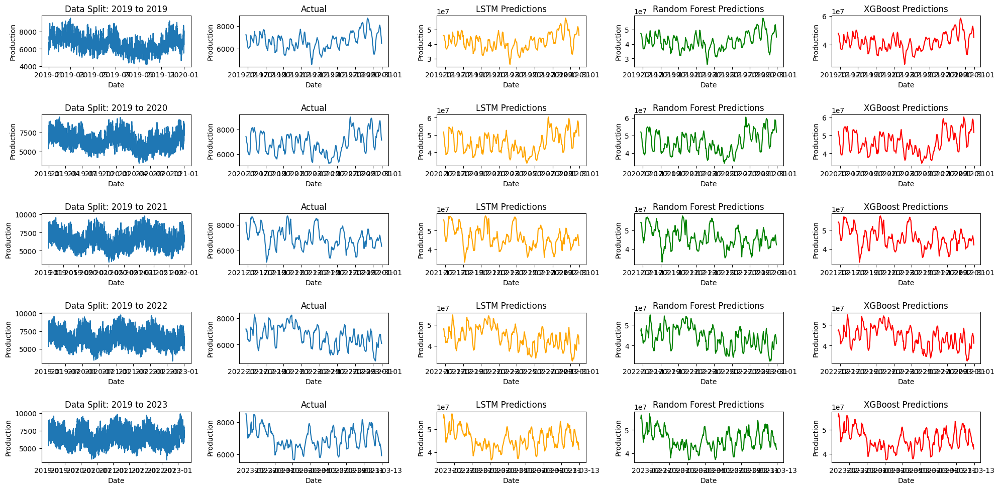

In [ ]:
plot_predictions(df, split_years, lstm_predictions, rf_predictions, xgb_predictions)

##**Conclusion:**

* In this project, we used a variety of models to analyze energy production
trends. We started by using an Energy Data Profiling Report to understand the dataset. Initially, we employed the Prophet model for forecasting, but the results were suboptimal. We then implemented an LSTM model to predict energy production for the next 30 days, achieving accurate forecasting.

* To gain deeper insights, we further split the data into seasons and years, allowing us to compare trends across different time periods. Additionally, we trained Random Forest (RF) and XGBoost models to predict energy production, and we found that LSTM gives better results.

* Overall, through our analysis and modeling techniques, we achieved accurate short-term energy production forecasts.

# **Hourly Electricity Consumption and Production for Turkey**

### **Dataset:**  
- Hourly Electricity Consumption and Production by Type in Turkey for 6 years

* **Production:** How much electricity is generated each hour (MW).

### Kaggle Link:
https://www.kaggle.com/datasets/ahmetzamanis/energy-consumption-and-pricing-trkiye-2018-2023


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense
from sklearn.metrics import mean_squared_error
import seaborn as sns
import warnings
import matplotlib.dates as mdt
warnings.filterwarnings('ignore')
from prophet import Prophet
from sklearn.model_selection import train_test_split

In [ ]:
df = pd.read_csv('/content/full_data.csv')

print('Hourly timeseries of electricity production in Turkey')
print('All values are in MWs')

print("Size of the dataset: ",df.shape)
print(" ")
print(df.info())

df

Hourly timeseries of electricity production in Turkey
All values are in MWs
Size of the dataset:  (52584, 22)
 
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52584 entries, 0 to 52583
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   time                  52584 non-null  object 
 1   consumption_MWh       52584 non-null  float64
 2   total_generation_MWh  52584 non-null  float64
 3   natural_gas           52584 non-null  float64
 4   hydro_dam             52584 non-null  float64
 5   lignite               52584 non-null  float64
 6   hydro_river           52584 non-null  float64
 7   coal_imported         52584 non-null  float64
 8   wind                  52584 non-null  float64
 9   solar                 52584 non-null  float64
 10  fuel_oil              52584 non-null  float64
 11  geothermal            52584 non-null  float64
 12  asphaltite_coal       52584 non-null  float64
 13  hard_coal

,time,consumption_MWh,total_generation_MWh,natural_gas,hydro_dam,lignite,hydro_river,coal_imported,wind,solar,...,asphaltite_coal,hard_coal,biomass,naphtha,LNG,international,waste_heat,TRY/MWh,USD/MWh,EUR/MWh
0,01:01:2018:00:00,27412.81,27412.81,6926.78,4820.40,5226.32,1900.32,5314.05,1179.51,0.0,...,278.20,189.50,210.96,0.0,0.0,297.00,92.08,207.60,55.04,45.97
1,01:01:2018:01:00,26324.39,26324.39,6603.44,3644.32,5277.19,1877.83,5715.61,1148.46,0.0,...,284.82,205.50,211.67,0.0,0.0,287.00,91.14,205.34,54.44,45.47
2,01:01:2018:02:00,24635.32,24635.32,6040.77,2711.00,5325.47,1708.49,5701.37,1216.38,0.0,...,278.20,201.50,209.89,0.0,0.0,169.00,91.06,164.94,43.73,36.53
3,01:01:2018:03:00,23872.12,23872.12,5938.46,2524.37,5265.91,1662.59,5205.43,1298.11,0.0,...,271.57,211.50,211.24,0.0,0.0,214.00,91.83,154.52,40.97,34.22
4,01:01:2018:04:00,23194.89,23194.89,5665.41,2462.71,5282.88,1697.96,4804.19,1220.91,0.0,...,273.78,307.50,214.31,0.0,0.0,203.00,91.23,112.64,29.86,24.95
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52579,31:12:2023:19:00,35090.93,34753.40,5567.82,8719.86,5311.18,2287.36,9100.92,359.70,0.0,...,130.27,613.05,997.70,0.0,0.0,270.20,82.49,2499.67,84.91,76.74
52580,31:12:2023:20:00,33310.94,31441.31,4792.96,7881.64,4908.48,2083.33,7613.93,459.87,0.0,...,132.48,612.95,983.26,0.0,0.0,539.84,85.01,2472.34,83.98,75.90
52581,31:12:2023:21:00,32083.96,30368.98,4000.94,7513.96,4911.94,1966.32,7656.56,552.62,0.0,...,132.48,607.59,977.02,0.0,0.0,629.91,84.63,2472.33,83.98,75.90
52582,31:12:2023:22:00,30469.49,30386.41,2903.52,8119.63,4615.93,1837.75,8390.47,720.11,0.0,...,130.27,608.31,987.47,0.0,0.0,627.77,83.35,1800.00,61.15,55.26


In [ ]:
!pip install -U ydata-profiling

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 359.5/359.5 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 6.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 10.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27080 sha256=1b6c30adf7db5628453907cde168466d697d385d5d04fad5471d5f476080e06f
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Successfully built htmlmin


In [ ]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df, title="Energy Data Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
import pandas as pd
selected_columns = ['time', 'total_generation_MWh']
df = df[selected_columns]
df = df.rename(columns={'total_generation_MWh': 'generation'})
df


,time,generation
0,01:01:2018:00:00,27412.81
1,01:01:2018:01:00,26324.39
2,01:01:2018:02:00,24635.32
3,01:01:2018:03:00,23872.12
4,01:01:2018:04:00,23194.89
...,...,...
52579,31:12:2023:19:00,34753.40
52580,31:12:2023:20:00,31441.31
52581,31:12:2023:21:00,30368.98
52582,31:12:2023:22:00,30386.41


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52584 entries, 0 to 52583
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   time        52584 non-null  object 
 1   generation  52584 non-null  float64
dtypes: float64(1), object(1)
memory usage: 821.8+ KB


In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
generation,52584.0,34399.243138,5272.179656,15333.3,30485.6975,34438.515,38188.935,51285.69


In [ ]:
df["time"] = pd.to_datetime(df["time"], format="%d:%m:%Y:%H:%M")
df["Month"] = df["time"].dt.month
df["Year"] = df["time"].dt.year
df["Date"] = df["time"].dt.date
df["Time"] = df["time"].dt.time
df["Week"] = df["time"].dt.isocalendar().week
df["Day"] = df["time"].dt.day_name()
df.head()

,time,generation,Month,Year,Date,Time,Week,Day
0,2018-01-01 00:00:00,27412.81,1,2018,2018-01-01,00:00:00,1,Monday
1,2018-01-01 01:00:00,26324.39,1,2018,2018-01-01,01:00:00,1,Monday
2,2018-01-01 02:00:00,24635.32,1,2018,2018-01-01,02:00:00,1,Monday
3,2018-01-01 03:00:00,23872.12,1,2018,2018-01-01,03:00:00,1,Monday
4,2018-01-01 04:00:00,23194.89,1,2018,2018-01-01,04:00:00,1,Monday


In [ ]:
print("")
print("Total Number of Years: ", df["Year"].nunique())
print(df["Year"].unique())


Total Number of Years:  6
[2018 2019 2020 2021 2022 2023]


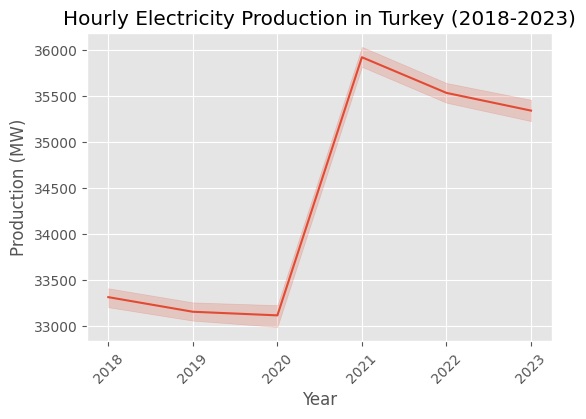

In [ ]:
from matplotlib import pyplot as plt
import seaborn as sns
plt.style.use('ggplot')
plt.figure(figsize=(6,4))
sns.lineplot(data=df, x='Year', y='generation')
plt.title('Hourly Electricity Production in Turkey (2018-2023)')
plt.xlabel('Year')
plt.ylabel('Production (MW)')
plt.grid(True)
plt.xticks(rotation=45)
plt.show()

Text(0.5, 1.0, 'Energy Distribution')

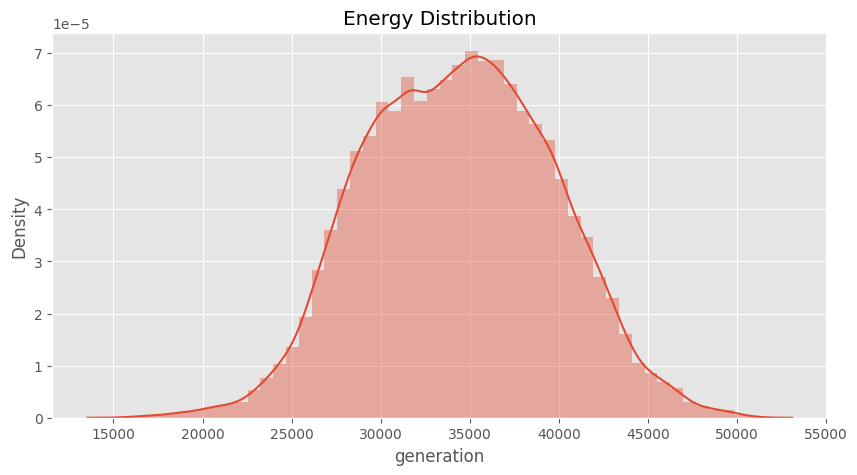

In [ ]:
fig = plt.figure(figsize = (10,5))
sns.distplot(df["generation"])
plt.title("Energy Distribution")

In [ ]:
print(df.shape)
y = df["generation"]
print(y[0])
y.shape

(52584, 8)
27412.81


(52584,)

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range = (0,1))
y = scaler.fit_transform(np.array(y).reshape(-1,1))
print("Normalizing data before model fitting")
print(y[:10])

Normalizing data before model fitting
[[0.33598629]
 [0.30571236]
 [0.25873162]
 [0.23750354]
 [0.21866669]
 [0.21524744]
 [0.22069743]
 [0.23759589]
 [0.25071101]
 [0.29125713]]


In [ ]:
training_size = int(len(y)*0.80)
test_size = len(y)- training_size
val_size = int(training_size*0.20)
train_data , test_data , val_data = y[0:training_size-val_size,:] , y[training_size:len(y),:1], y[len(y)-test_size-val_size:len(y)-test_size,:1]

def create_dataset(dataset, time_step = 1):
  dataX, dataY = [] , []
  for i in range(len(dataset)-time_step-1):
    a = dataset[i:(i+time_step),0]
    dataX.append(a)
    dataY.append(dataset[i + time_step,0])
  return np.array(dataX), np.array(dataY)

In [ ]:
time_step = 100
X_train, y_train = create_dataset(train_data, time_step)
X_test, ytest = create_dataset(test_data, time_step)
X_val, yval = create_dataset(val_data, time_step)

X_train = X_train.reshape(X_train.shape[0],X_train.shape[1], 1)
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1],1)
X_val = X_val.reshape(X_val.shape[0], X_val.shape[1],1)

print("X_train shape: ", X_train.shape)
print("X_test shape: ",X_test.shape)
print("X_val shape: ",X_val.shape)

X_train shape:  (33553, 100, 1)
X_test shape:  (10416, 100, 1)
X_val shape:  (8312, 100, 1)


In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout

model = Sequential()
model.add(LSTM(units = 50, return_sequences = True, input_shape = (time_step, 1)))
model.add(Dropout(0.2))
model.add(LSTM(units = 50, return_sequences = True))
model.add(LSTM(units = 50, return_sequences = True))
model.add(LSTM(units = 50))
model.add(Dense(units = 1))

model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_12 (LSTM)              (None, 100, 50)           10400     
                                                                 
 dropout_3 (Dropout)         (None, 100, 50)           0         
                                                                 
 lstm_13 (LSTM)              (None, 100, 50)           20200     
                                                                 
 lstm_14 (LSTM)              (None, 100, 50)           20200     
                                                                 
 lstm_15 (LSTM)              (None, 50)                20200     
                                                                 
 dense_3 (Dense)             (None, 1)                 51        
                                                                 
Total params: 71051 (277.54 KB)
Trainable params: 7105

In [ ]:
history = model.fit(X_train, y_train, validation_data = (X_val,yval), verbose = 1,epochs = 10 ,batch_size = 16)

Epoch 1/10
2098/2098 [==============================] - 50s 20ms/step - loss: 0.0054 - val_loss: 0.0025
Epoch 2/10
2098/2098 [==============================] - 40s 19ms/step - loss: 0.0014 - val_loss: 0.0011
Epoch 3/10
2098/2098 [==============================] - 41s 19ms/step - loss: 8.7291e-04 - val_loss: 6.3093e-04
Epoch 4/10
2098/2098 [==============================] - 41s 19ms/step - loss: 6.3242e-04 - val_loss: 5.5996e-04
Epoch 5/10
2098/2098 [==============================] - 41s 19ms/step - loss: 5.1731e-04 - val_loss: 4.4293e-04
Epoch 6/10
2098/2098 [==============================] - 40s 19ms/step - loss: 4.7732e-04 - val_loss: 0.0011
Epoch 7/10
2098/2098 [==============================] - 41s 20ms/step - loss: 4.1971e-04 - val_loss: 4.5073e-04
Epoch 8/10
2098/2098 [==============================] - 40s 19ms/step - loss: 3.6738e-04 - val_loss: 3.9564e-04
Epoch 9/10
2098/2098 [==============================] - 40s 19ms/step - loss: 3.2732e-04 - val_loss: 2.7963e-04
Epoch 10/10


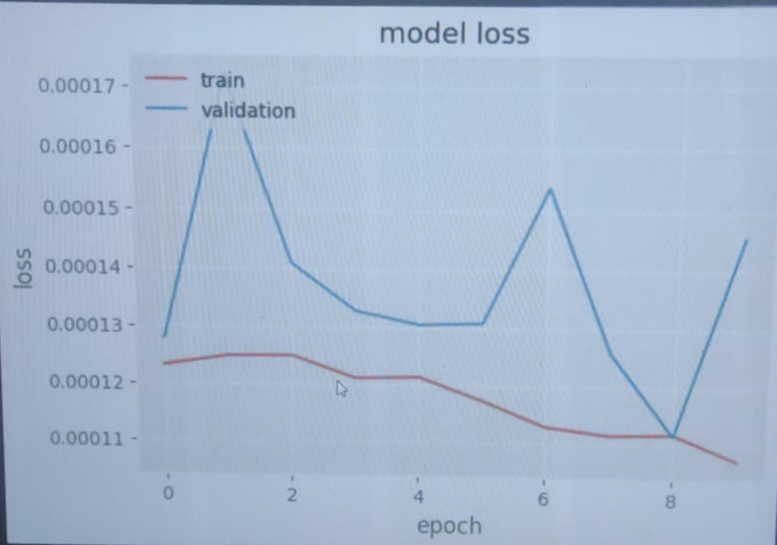

In [ ]:
train_predict=model.predict(X_train)
test_predict=model.predict(X_test)

326/326 [==============================] - 3s 9ms/step


In [ ]:
train_predict=scaler.inverse_transform(train_predict)
test_predict=scaler.inverse_transform(test_predict)

In [ ]:
import math
from sklearn.metrics import mean_squared_error
train_rmse=math.sqrt(mean_squared_error(y_train,train_predict))
train_rmse=np.sqrt(train_rmse)
print('Train RMSE:', train_rmse)

Train RMSE: 187.46261792886517


In [ ]:
import math
from sklearn.metrics import mean_squared_error
test_rmse=math.sqrt(mean_squared_error(ytest,test_predict))
test_rmse=np.sqrt(test_rmse)
print('Test RMSE:', test_rmse)

Test RMSE: 191.46144719790988


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

X = df[['Month', 'Year', 'Week']]  # Example features, choose relevant columns from your dataset
y = df['generation']  # Target variable
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Step 3: Train the Random Forest model
def train_random_forest_model(X_train, y_train):
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    model.fit(X_train, y_train)
    return model

rf_model = train_random_forest_model(X_train, y_train)

# Step 4: Evaluate the model's performance
y_pred = rf_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
print("Mean Squared Error:", mse)


Mean Squared Error: 17262627.12523044


In [ ]:
rmse = np.sqrt(mse)
print("Root Mean Squared Error:", rmse)


Root Mean Squared Error: 4154.831780617651
